In [46]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.svm import SVC
import matplotlib.pyplot as plt
import seaborn as sns
import kagglehub
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    classification_report,
)


In [47]:
path = kagglehub.dataset_download("seymasa/rice-dataset-gonenjasmine")
df = pd.read_csv(path + "/Rice-Gonen andJasmine.csv")

# Проверяем уникальные значения в столбце Class
print(df["Class"].unique())

# Преобразуем метки классов
X = df.drop("Class", axis=1)
y, y_labels = pd.factorize(df["Class"])
y = np.where(y == 0, -1, y)
X


['jasmine' 'Gonen']


,id,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation
0,1,4537,92.229316,64.012769,0.719916,4677,76.004525,0.657536,273.085,0.764510,1.440796
1,2,2872,74.691881,51.400454,0.725553,3015,60.471018,0.713009,208.317,0.831658,1.453137
2,3,3048,76.293164,52.043491,0.731211,3132,62.296341,0.759153,210.012,0.868434,1.465950
3,4,3073,77.033628,51.928487,0.738639,3157,62.551300,0.783529,210.657,0.870203,1.483456
4,5,3693,85.124785,56.374021,0.749282,3802,68.571668,0.769375,230.332,0.874743,1.510000
...,...,...,...,...,...,...,...,...,...,...,...
18180,18181,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535
18181,18182,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910
18182,18183,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396
18183,18184,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216


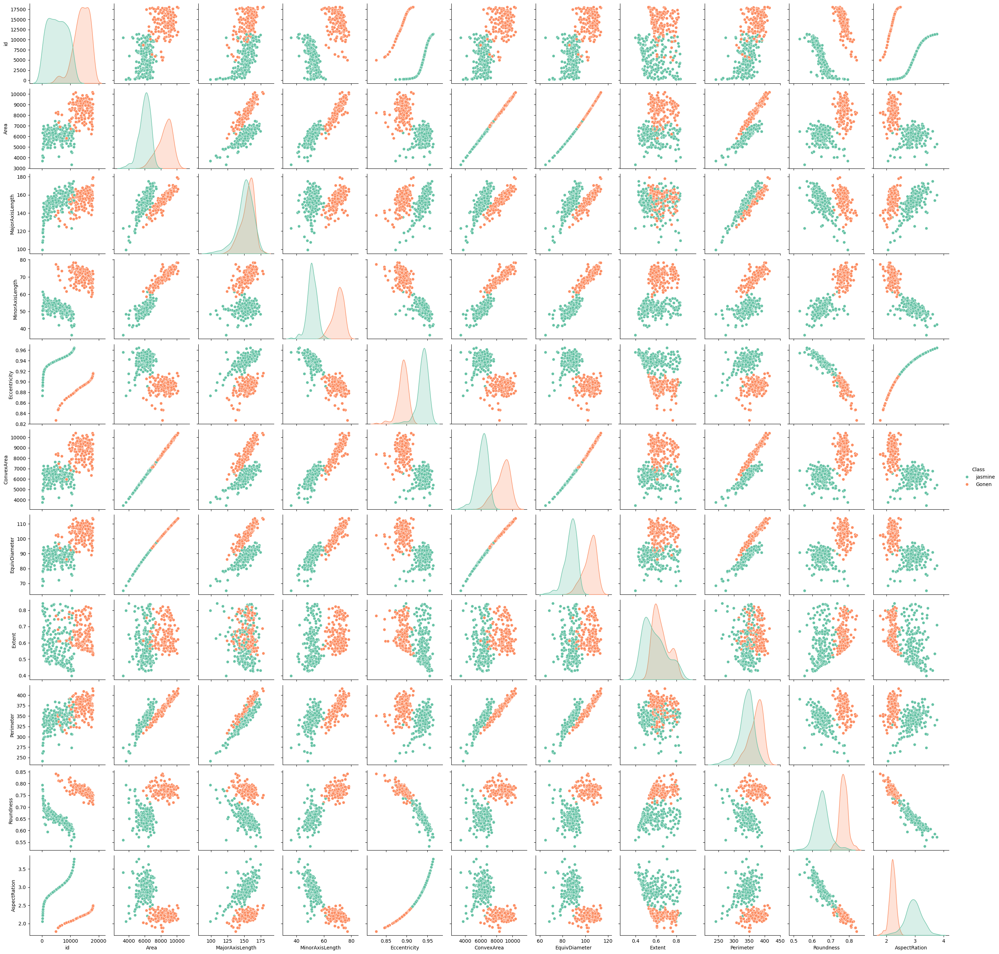

In [48]:
subsize = 0.02
splitter = StratifiedShuffleSplit(
    n_splits=1, train_size=0.8 * subsize, test_size=0.2 * subsize, random_state=0
)


for train_index, test_index in splitter.split(X, y):
    df_splitted = df.iloc[np.concatenate([train_index, test_index])]
    X_train = df.drop("Class", axis=1).iloc[train_index]
    X_test = df.drop("Class", axis=1).iloc[test_index]
    y_train, y_test = y[train_index], y[test_index]

sns.pairplot(df_splitted, hue="Class", palette="Set2")


In [49]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00        40
           1       1.00      1.00      1.00        33

    accuracy                           1.00        73
   macro avg       1.00      1.00      1.00        73
weighted avg       1.00      1.00      1.00        73



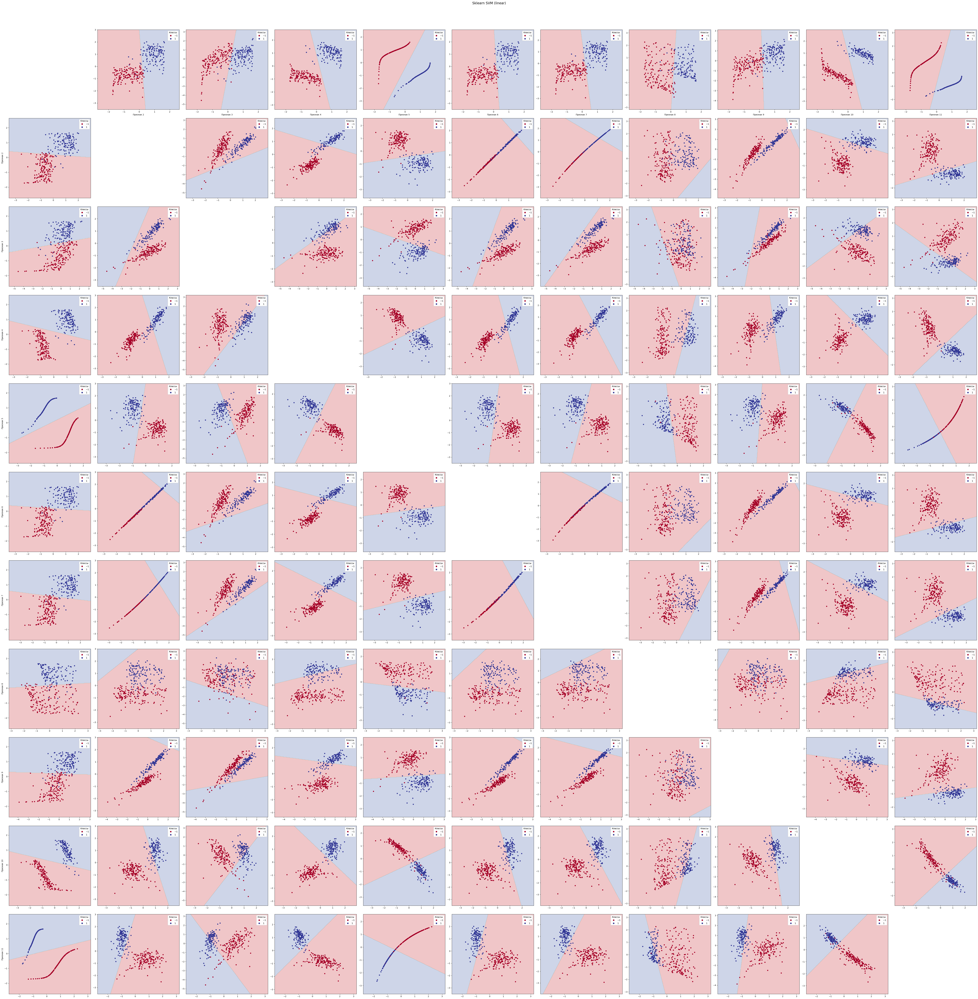

In [50]:
import itertools


def linear_kernel(x1, x2):
    return np.dot(x1, x2)


sklearn_svm = SVC(kernel="linear", C=1.0)
sklearn_svm.fit(X_train_scaled, y_train)
sklearn_pred = sklearn_svm.predict(X_test_scaled)


def plot_decision_boundary(X, y, model, title):
    n_features = X.shape[1]
    grid_points = 250
    grid_step = 1 / grid_points

    _fig, axes = plt.subplots(
        n_features, n_features, figsize=(6 * n_features, 6 * n_features)
    )
    plt.suptitle(title, y=1.02, fontsize=16)
    for ax in axes[np.eye(n_features, dtype=bool)]:
        ax.set_visible(False)
    for i, j in itertools.product(range(n_features), range(n_features)):
        if i == 0:
            axes[i, j].set_xlabel(f"Признак {j+1}", loc="center")
        if j == 0:  # Подписи осей Y только для левого столбца
            axes[i, j].set_ylabel(f"Признак {i+1}", loc="center")

    for i, j in itertools.permutations(range(n_features), 2):
        # Создаем сетку для визуализации с отступом 1 от границ данных
        margin = 1
        x_min, x_max = X[:, i].min() - margin, X[:, i].max() + margin
        y_min, y_max = X[:, j].min() - margin, X[:, j].max() + margin

        # Создаем равномерную сетку с 100 точками
        h_scaled = grid_step * (x_max - x_min)  # шаг сетки
        xx, yy = np.meshgrid(
            np.arange(x_min, x_max, h_scaled), np.arange(y_min, y_max, h_scaled)
        )

        # Предсказываем значения для всех точек сетки
        grid = np.zeros((xx.shape[0] * grid_points, n_features))
        grid[:, [i, j]] = np.c_[xx.ravel(), yy.ravel()]
        Z = model.predict(grid).reshape(xx.shape)

        # Рисуем на соответствующем месте в сетке
        contour = axes[i, j].contourf(xx, yy, Z, cmap=plt.cm.RdYlBu, alpha=0.25)
        scatter = axes[i, j].scatter(X[:, i], X[:, j], c=y, cmap=plt.cm.RdYlBu, s=20)

        # Добавляем легенду для каждого графика
        legend1 = axes[i, j].legend(
            *scatter.legend_elements(), title="Классы", loc="upper right"
        )
        axes[i, j].add_artist(legend1)

    plt.tight_layout()
    plt.show()


print(classification_report(y_test, sklearn_svm.predict(X_test_scaled)))

plot_decision_boundary(X_train_scaled, y_train, sklearn_svm, "Sklearn SVM (linear)")


In [51]:
def linear_kernel(x1: np.ndarray, x2: np.ndarray) -> np.ndarray:
    return np.dot(x1, x2.T)


def polynomial_kernel(x1, x2, degree=3):
    return (1 + np.dot(x1, x2.T)) ** degree


def rbf_kernel(x1, x2, gamma=0.1):
    return np.exp(-gamma * np.linalg.norm(x1 - x2) ** 2)


class SVM:
    def __init__(self, kernel=linear_kernel, C=1.0):
        self.kernel = kernel
        self.C = C
        self.lambda_values = None
        self.support_vectors = None
        self.support_vector_labels = None
        self.b = 0
        self.X = None
        self.y = None

    def dual_objective_function(self, lambda_values):
        return -np.sum(lambda_values) + 0.5 * np.sum(
            (self.kernel(self.X, self.X))
            * np.outer(self.y, self.y)
            * np.outer(lambda_values, lambda_values)
        )

    def fit(self, X, y):
        self.X = X
        self.y = y
        n_samples, _n_features = X.shape

        lambda_init = np.random.rand(n_samples)
        constraints = [{"type": "eq", "fun": lambda x: np.sum(x * self.y)}]
        bounds = [(0.0, self.C) for _ in range(n_samples)]

        solution = minimize(
            self.dual_objective_function,
            lambda_init,
            method="SLSQP",
            bounds=bounds,
            constraints=constraints,
            options={"maxiter": 100},
        )

        self.lambda_values = solution.x

        support_vector_indices = self.lambda_values > 1e-6
        print(f"Найдено опорных векторов: {np.sum(support_vector_indices)}")
        self.support_vectors = X[support_vector_indices]
        self.support_vector_labels = y[support_vector_indices]
        self.lambda_values = self.lambda_values[support_vector_indices]

        self.calculate_bias()

        return self

    def calculate_bias(self):
        if len(self.support_vectors) == 0:
            self.b = 0
            return

        return np.mean(
            self.support_vector_labels
            - (
                np.dot(
                    self.lambda_values * self.support_vector_labels,
                    self.kernel(self.support_vectors, self.support_vectors),
                )
            )
        )

    def predict(self, X):
        kernel_matrix = self.kernel(self.support_vectors, X)

        weighted_sum = np.dot(
            self.lambda_values * self.support_vector_labels, kernel_matrix
        )

        return np.sign(weighted_sum - self.b)


Найдено опорных векторов: 4
Вычисленное смещение b: 0
              precision    recall  f1-score   support

          -1       1.00      1.00      1.00        40
           1       1.00      1.00      1.00        33

    accuracy                           1.00        73
   macro avg       1.00      1.00      1.00        73
weighted avg       1.00      1.00      1.00        73



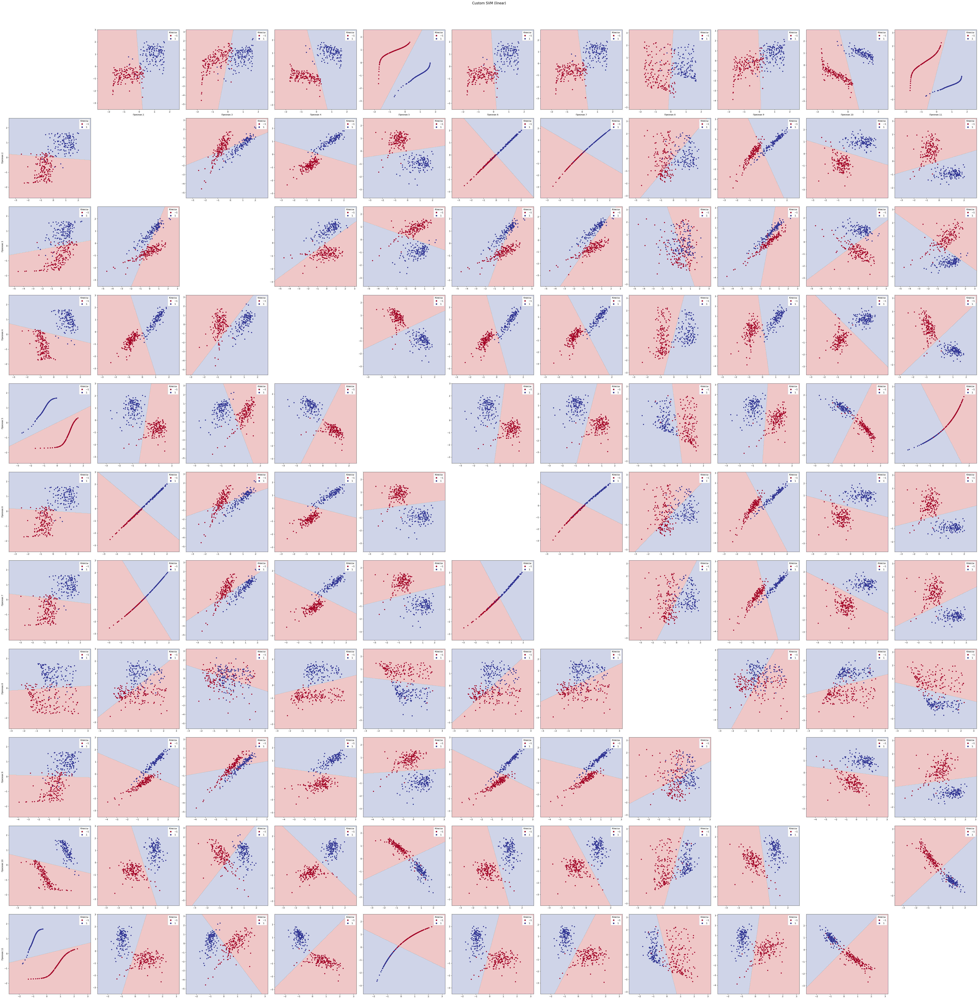

In [57]:
custom_svm = SVM(kernel=linear_kernel, C=1.0)
custom_svm.fit(X_train_scaled, y_train)
print(classification_report(y_test, custom_svm.predict(X_test_scaled)))
plot_decision_boundary(
    X_train_scaled,
    y_train,
    custom_svm,
    "Custom SVM (linear)",
)


Найдено опорных векторов: 11
Вычисленное смещение b: 0
              precision    recall  f1-score   support

          -1       1.00      1.00      1.00        40
           1       1.00      1.00      1.00        33

    accuracy                           1.00        73
   macro avg       1.00      1.00      1.00        73
weighted avg       1.00      1.00      1.00        73



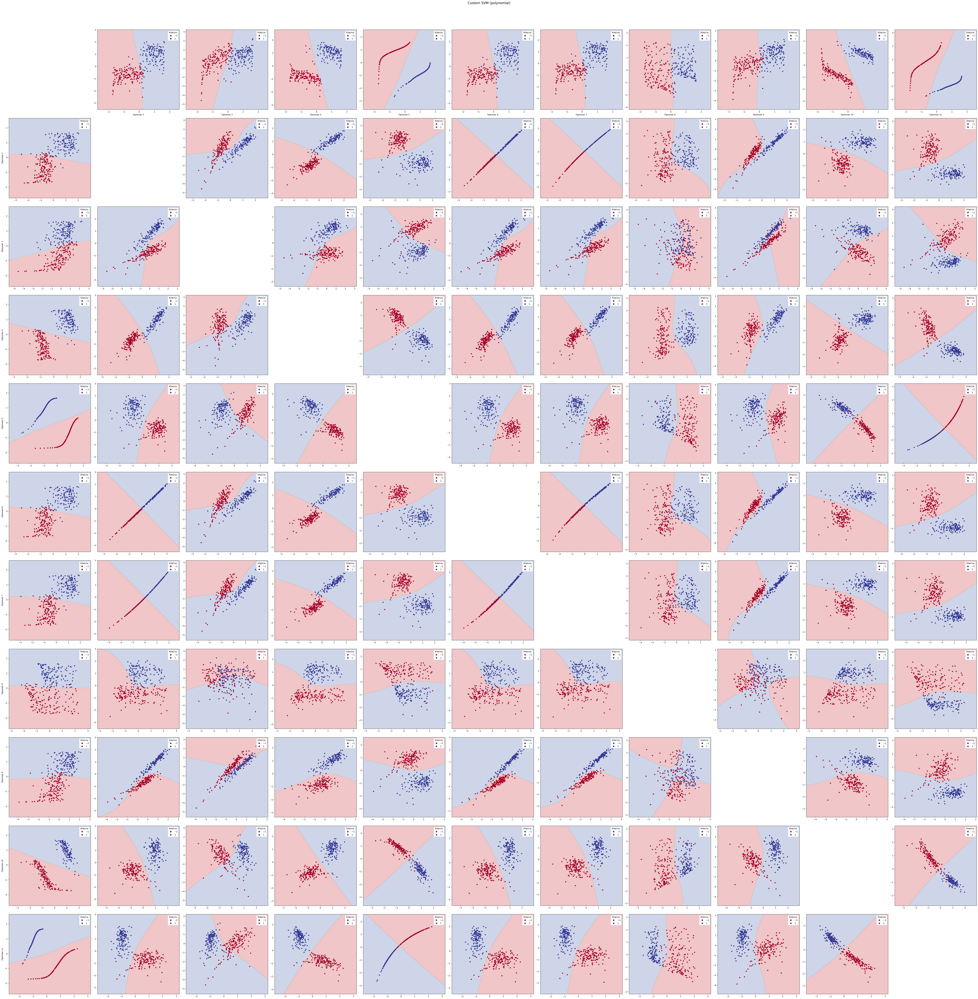

In [53]:
custom_svm = SVM(kernel=polynomial_kernel, C=1.0)
custom_svm.fit(X_train_scaled, y_train)
print(
    classification_report(
        y_test,
        custom_svm.predict(X_test_scaled),
    )
)
plot_decision_boundary(
    X_train_scaled,
    y_train,
    custom_svm,
    "Custom SVM (polynomial)",
)


Найдено опорных векторов: 33
Вычисленное смещение b: 0
              precision    recall  f1-score   support

          -1       1.00      1.00      1.00        40
           1       1.00      1.00      1.00        33

    accuracy                           1.00        73
   macro avg       1.00      1.00      1.00        73
weighted avg       1.00      1.00      1.00        73



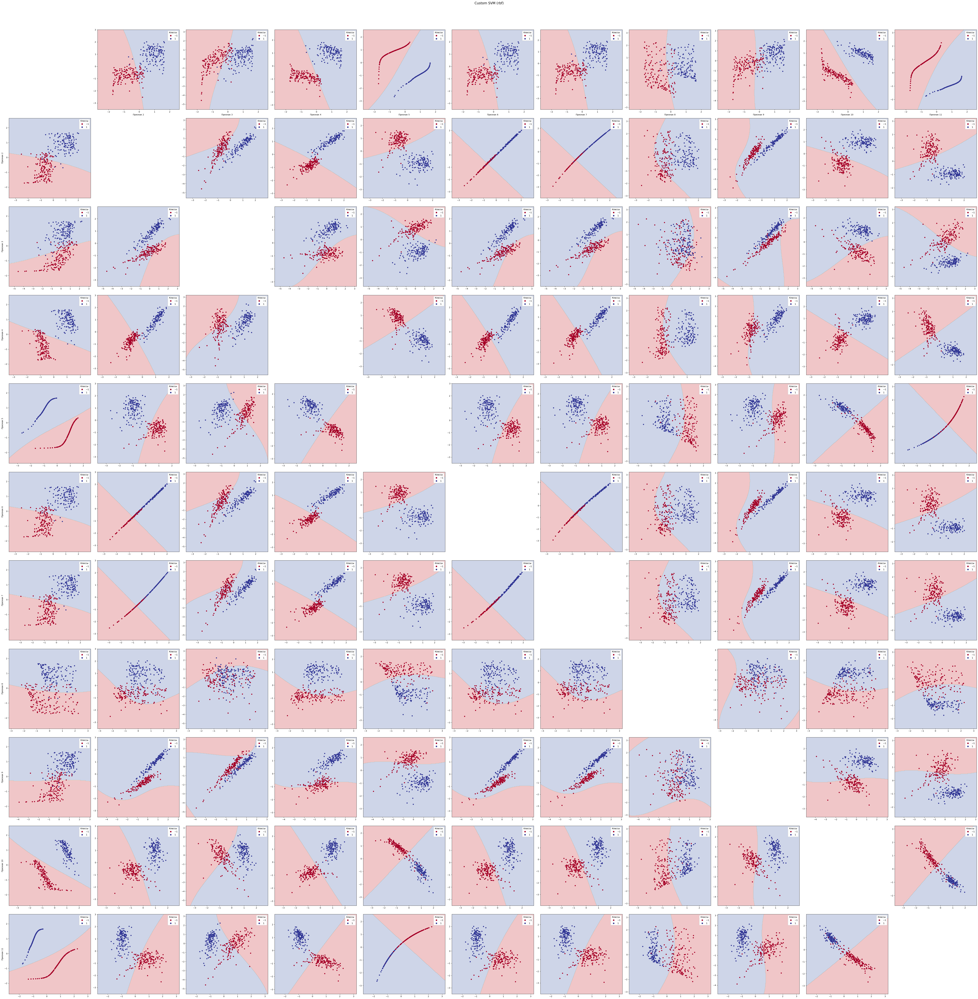

In [54]:
def rbf_kernel(x1, x2, gamma=0.1):
    diff = x1[:, np.newaxis, :] - x2[np.newaxis, :, :]
    sq_dist = np.sum(diff**2, axis=2)
    return np.exp(-gamma * sq_dist)


custom_svm = SVM(kernel=rbf_kernel, C=1.0)
custom_svm.fit(X_train_scaled, y_train)
print(classification_report(y_test, custom_svm.predict(X_test_scaled)))

plot_decision_boundary(
    X_train_scaled,
    y_train,
    custom_svm,
    "Custom SVM (rbf)",
)


In [55]:
%%timeit
custom_svm.fit(X_train_scaled, y_train)


Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
Найдено опорных векторов: 33
Вычисленное смещение b: 0
16.4 s ± 314 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [56]:
%%timeit
sklearn_svm.fit(X_train_scaled, y_train)


365 μs ± 6.32 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)
